In [ ]:
import os
import numpy
import pandas
import matplotlib.pyplot
from data import dataset_list
from model import model_list
from irt import Beta_3_IRT
%matplotlib inline

In [ ]:
res = pandas.read_csv('./res/res_sparse.csv', header=None).to_numpy()

In [ ]:
target_measure = 3

In [ ]:
mdl = Beta_3_IRT()

In [ ]:
mdl.fit(dataset_list, 
        res[:, 1].astype('int'), 
        model_list, 
        res[:, 0].astype('int'), 
        res,
        target_measure)

In [ ]:
numpy.savetxt(fname='./irt/' + str(target_measure) + '_logit_theta_beta3.csv', X=mdl.logit_theta, delimiter=',')
numpy.savetxt(fname='./irt/' + str(target_measure) + '_logit_delta_beta3.csv', X=mdl.logit_delta, delimiter=',')
numpy.savetxt(fname='./irt/' + str(target_measure) + '_log_a_beta3.csv', X=mdl.log_a, delimiter=',')
logit_theta = numpy.loadtxt(fname='./irt/' + str(target_measure) + '_logit_theta_beta3.csv', delimiter=',')
logit_delta = numpy.loadtxt(fname='./irt/' + str(target_measure) + '_logit_delta_beta3.csv', delimiter=',')
log_a = numpy.loadtxt(fname='./irt/' + str(target_measure) + '_log_a_beta3.csv', delimiter=',')

In [ ]:
theta = 1 / (1 + numpy.exp(logit_theta))
delta = 1 / (1 + numpy.exp(logit_delta))
a = numpy.exp(log_a)

In [ ]:
matplotlib.pyplot.figure(figsize=(16, 9))
matplotlib.pyplot.bar(numpy.arange(0, len(theta)), theta)
matplotlib.pyplot.xticks(numpy.arange(0, len(model_list)), model_list, rotation=90);
matplotlib.pyplot.xlim([-1, len(model_list)])
matplotlib.pyplot.grid()
matplotlib.pyplot.title('ability')
matplotlib.pyplot.savefig('./irt/ability_beta3.png')

In [ ]:
matplotlib.pyplot.figure(figsize=(32, 9))
matplotlib.pyplot.bar(numpy.arange(0, len(delta)), delta)
matplotlib.pyplot.xticks(numpy.arange(0, len(dataset_list)), dataset_list, rotation=90);
matplotlib.pyplot.grid()
matplotlib.pyplot.title('difficulty')
matplotlib.pyplot.savefig('./irt/difficulty_beta3.png')

In [ ]:
matplotlib.pyplot.figure(figsize=(32, 9))
matplotlib.pyplot.bar(numpy.arange(0, len(a)), a)
matplotlib.pyplot.xticks(numpy.arange(0, len(dataset_list)), dataset_list, rotation=90);
matplotlib.pyplot.grid()
matplotlib.pyplot.title('discrimination')
matplotlib.pyplot.savefig('./output/discrimination_beta3.png')

In [ ]:
v_theta = numpy.linspace(1e-16, 1-1e-16, 1024).reshape(1, -1)
v_r = numpy.linspace(1e-16, 1-1e-16, 1024).reshape(1, -1)
v_delta = delta.reshape(-1, 1)
v_a = a.reshape(-1, 1)
v_delta[v_delta==1] = 1 - 1e-16
v_delta[v_delta==0] = 1e-16

In [ ]:
alpha = numpy.power(v_theta / v_delta, numpy.repeat(v_a, numpy.shape(v_theta)[0], axis=1))
beta = numpy.power((1-v_theta) / (1-v_delta), numpy.repeat(v_a, numpy.shape(v_theta)[0], axis=1))
mu = alpha / (alpha + beta)
std = numpy.sqrt((alpha*beta) / ((alpha + beta)**2 * (alpha + beta + 1)))
mu_ps = mu + std
mu_ns = mu - std

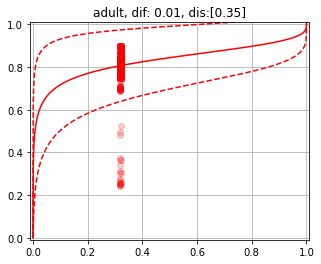

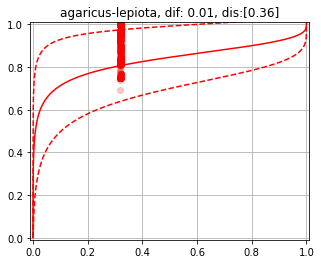

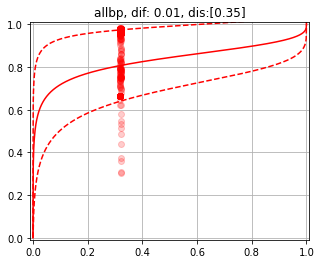

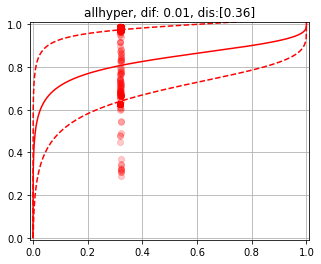

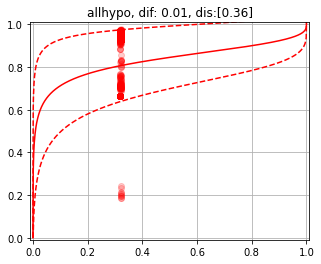

...

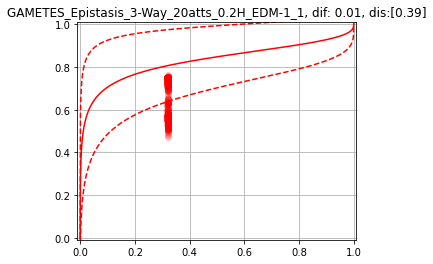

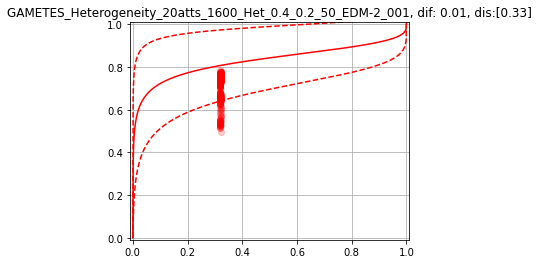

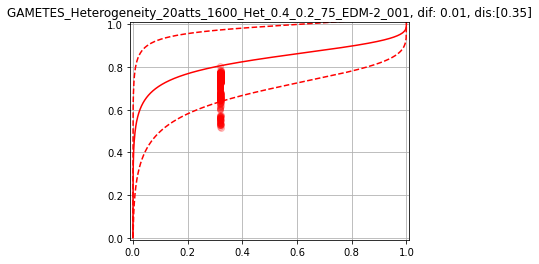

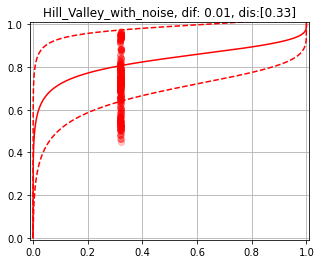

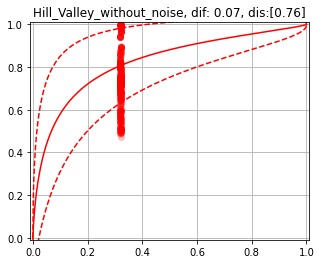

In [13]:
for i in range(0, len(dataset_list)):
    matplotlib.pyplot.figure(figsize=(5, 4))
    matplotlib.pyplot.plot(v_theta.ravel(), mu[i, :], 'r')
    matplotlib.pyplot.plot(v_theta.ravel(), mu_ps[i, :], '--r')
    matplotlib.pyplot.plot(v_theta.ravel(), mu_ns[i, :], '--r')
    matplotlib.pyplot.title(dataset_list[i] + ', dif: ' + str(numpy.around(delta[i], 2)) + 
                            ', dis:' + str(numpy.around(v_a[i], 2)))
    idx = (res[:, 1] == i)
    matplotlib.pyplot.plot(theta[res[idx, 0].astype('int')], res[idx, target_measure], 'ro', alpha=0.2)
    matplotlib.pyplot.xlim([-1e-2, 1+1e-2])
    matplotlib.pyplot.ylim([-1e-2, 1+1e-2])
    matplotlib.pyplot.grid()
    matplotlib.pyplot.savefig('./output/' + dataset_list[i] + '_beta3.png')